In [191]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import seaborn as sns
import geopandas as gpd
import folium
from shapely.geometry import Point, Polygon
from folium import plugins
import branca.colormap as cm
from folium.plugins import TimestampedGeoJson
from folium.plugins import HeatMap
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from k_means_constrained import KMeansConstrained
from folium.map import *
from shapely.geometry import MultiPoint
from sklearn.neighbors import RadiusNeighborsClassifier



Read in data and clean it. 

In [192]:
#Read in files from csv and fix timestamp formating 
mobilesensors=pd.read_csv('/Users/alexanderlindell/Documents/Programmering /Python/TNM098/Project/VC files/data/MobileSensorReadings.csv')
mobilesensors['Timestamp']=pd.to_datetime(mobilesensors['Timestamp'])

staticsensors=pd.read_csv('/Users/alexanderlindell/Documents/Programmering /Python/TNM098/Project/VC files/data/StaticSensorReadings.csv')
staticsensors['Timestamp']=pd.to_datetime(staticsensors['Timestamp'])

staticlocations=pd.read_csv('/Users/alexanderlindell/Documents/Programmering /Python/TNM098/Project/VC files/data/StaticSensorLocations.csv')
staticlocations=staticlocations.reindex([5,8,4,6,0,1,2,7,3]) #Reindexing sensor by sensors distance from each other. 

#Delete junk columns
mobilesensors=mobilesensors.drop(columns=['Units',' User-id'])
staticsensors=staticsensors.drop(columns=['Units'])

#Add latitude and longitude to staticsensors dataframe
temp1=[]
temp2=[]
for index, row in staticsensors.iterrows():
    temp1.append(staticlocations.loc[staticlocations['Sensor-id']==row['Sensor-id']]['Long'].values[0])
    temp2.append(staticlocations.loc[staticlocations['Sensor-id']==row['Sensor-id']]['Lat'].values[0])
staticsensors['Long']=temp1
staticsensors['Lat']=temp2
staticsensors

#Join mobilesensors and staticsensors in one dataframe
tempmobilesensorsdata=mobilesensors
tempstaticsensorsdata=staticsensors
tempmobilesensorsdata['TypeSensor']='Mobilesensor'
tempstaticsensorsdata['TypeSensor']='Staticsensor'
mobileandstatic=pd.concat([tempmobilesensorsdata,tempstaticsensorsdata])
mobileandstatic=mobileandstatic.sort_values(by='Timestamp')
mobileandstatic


,Timestamp,Sensor-id,Long,Lat,Value,TypeSensor
0,2020-04-06 00:00:00,15,-119.830350,0.140070,0.000000,Mobilesensor
32,2020-04-06 00:00:00,19,-119.904880,0.149640,0.000000,Mobilesensor
33,2020-04-06 00:00:00,29,-119.749440,0.062060,0.000000,Mobilesensor
34,2020-04-06 00:00:00,38,-119.890380,0.160370,0.000000,Mobilesensor
35,2020-04-06 00:00:00,12,-119.841660,0.190530,0.000000,Mobilesensor
...,...,...,...,...,...,...
3315683,2020-04-10 23:59:45,42,-119.818514,0.121926,63.021773,Mobilesensor
3315682,2020-04-10 23:59:45,46,-119.823221,0.103867,39.667526,Mobilesensor
3315681,2020-04-10 23:59:45,26,-119.862228,0.055537,35.000000,Mobilesensor
743998,2020-04-10 23:59:45,9,-119.855580,0.182990,16.203000,Staticsensor


Create geodataframes for visualisations in geopandas

In [194]:
#Mobile and static sensors geodataframe
geometry = [Point(xy) for xy in zip(mobileandstatic['Long'], mobileandstatic['Lat'])]
geo_mobileandstatic = gpd.GeoDataFrame(mobileandstatic, 
                          crs = {'init':'EPSG:4326'}, 
                          geometry = geometry)                          

#Mobilesensors
geometry = [Point(xy) for xy in zip(mobilesensors['Long'], mobilesensors['Lat'])]
geo_mobilesensors = gpd.GeoDataFrame(mobilesensors, 
                          crs = {'init':'EPSG:4326'}, 
                          geometry = geometry)                          

#Create geodataframe for staticsensors
geometry = [Point(xy) for xy in zip(staticsensors['Long'], staticsensors['Lat'])]
geo_staticsensors = gpd.GeoDataFrame(staticsensors, 
                          crs = {'init':'EPSG:4326'}, 
                          geometry = geometry)     

#Staticsensors locations 
geometrystatic = [Point(xy) for xy in zip(staticlocations['Long'], staticlocations['Lat'])]
geo_staticlocations = gpd.GeoDataFrame(staticlocations, 
                          crs = {'init':'EPSG:4326'}, 
                          geometry = geometrystatic)
                          

#Nuclear power plant
plant=[Point(-119.784825,0.162679)]
geo_plant=gpd.GeoDataFrame(plant, 
                          crs = {'init':'EPSG:4326'}, 
                          geometry = plant)

#Read in shapefile to geomapdataframe
shapefile=gpd.read_file('/Users/alexanderlindell/Documents/Programmering /Python/TNM098/Project/VC files/data/StHimarkNeighborhoodShapefile/StHimark.shp')
#shapefile=map.to_crs(epsg=4326)
#shapefile.plot('Nbrhood', cmap='Blues', legend=False,figsize=(12,8))


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' s

Plots over sensor readings to identify bad data and general background radiation. 

In [ ]:
#Plot mobilesensor readings to map
fig, ax = plt.subplots(figsize = (20,20))
map.plot('Nbrhood', color='lightgrey', edgecolor='black', ax=ax)
geo_mobilestatic.plot(column ='cluster', ax=ax, cmap = 'hsv', legend = True, legend_kwds={'shrink': 0.3},alpha = 0.8)
geo_staticlocations.plot(ax=ax,c='white',edgecolor='black',legend=True,markersize=5000,alpha=0.2,label='Sensor-id')

geo_plant.plot(ax=ax,c='yellow',legend=True,edgecolor='black',label='Always safe nuclear plant',markersize=500,alpha=0.9)
for x,y,label in zip(geo_staticlocations.geometry.x,geo_staticlocations.geometry.y,geo_staticlocations['Sensor-id']):
    ax.annotate('Sensor-id:'+str(label),xy=(x,y),xytext=(-30,-3),textcoords='offset points')
ax.annotate('Always safe nuclear plant',xy=(geo_plant.geometry.x,geo_plant.geometry.y),xytext=(13,-3),textcoords='offset points')
    


In [ ]:
#Lineplot per day for mobilesensors mean value grouped by hour and colorcoded to each sensor. 
mobilesensors_timeasindex=mobilesensors.set_index('Timestamp')
mobilesensors_timeasindex['Hour']=mobilesensors_timeasindex.index.hour
mobilesensors_timeasindex['Day']=mobilesensors_timeasindex.index.day
uniquemobilesensors=np.sort(mobilesensors['Sensor-id'].unique())
fig, axes = plt.subplots(len(uniquemobilesensors),5, figsize=(30, 100),sharex=True)
for day in range(6,11):
    tempdata=mobilesensors_timeasindex.loc[mobilesensors_timeasindex['Day']==day]
    fignum=0
    for row in uniquemobilesensors:
        x=tempdata.loc[tempdata['Sensor-id']==row]['Hour']
        y=tempdata.loc[tempdata['Sensor-id']==row]
        y=y.groupby(y.index.hour)['Value']
        axes[fignum][day-6].boxplot(x,y)
        axes[fignum][day-6].set_xlabel('Day: '+str(day)+' Sensor-id: '+str(row))
        fignum+=1
    

In [ ]:
#Lineplot per day for mobilesensors mean value grouped by hour and colorcoded to each sensor. 
mobilesensors_timeasindex=mobilesensors.set_index('Timestamp')
mobilesensors_timeasindex['Hour']=mobilesensors_timeasindex.index.hour
mobilesensors_timeasindex['Day']=mobilesensors_timeasindex.index.day
uniquemobilesensors=np.sort(mobilesensors['Sensor-id'].unique())
fig, axes = plt.subplots(len(uniquemobilesensors),1, figsize=(30, 100),sharex=True)
for row in uniquemobilesensors:
    #x=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Hour']
    y=tempdata.loc[tempdata['Sensor-id']==row]
    ystd=y.groupby(y.index.hour)['Value'].std()
    ymean=y.groupby(y.index.hour)['Value'].mean()
    axes[row-1].plot(ystd.index,ystd,label='STD',color='r')
    axes[row-1].bar(ymean.index,ymean,width=0.1,label='Mean',color='b')
    axes[row-1].set_xlabel(' Sensor-id: '+str(row))
    axes[row-1].legend()

In [ ]:
#Lineplot per day for mobilesensors mean value grouped by hour and colorcoded to each sensor. 
mobilesensors_timeasindex=mobilesensors.set_index('Timestamp')
mobilesensors_timeasindex=mobilesensors_timeasindex.loc[mobilesensors_timeasindex['Value']>80]
uniquemobilesensors=np.sort(mobilesensors_timeasindex['Sensor-id'].unique())
fig, axes = plt.subplots(len(uniquemobilesensors),1, figsize=(30, 100),sharex=True,sharey=True)
fignum=0
for row in uniquemobilesensors:
    #x=mobilesensors_timeasindex.loc[mobilesensors_timeasindex['Sensor-id']==rows['Sensor-id']]['Hour']
    y=mobilesensors_timeasindex.loc[mobilesensors_timeasindex['Sensor-id']==row]
    #ystd=y.groupby(y.index.hour)['Value'].std()
    #ycount=y.groupby(y.index.hour)['Value'].count()
    #ymean=y.groupby(y.index.hour)['Value'].mean()
    yvalues=y.groupby(y.index.hour)['Value'].sum()
    """ Table({'Std':y.groupby(y.index.hour)['Value'].std().values,
        'Count': y.groupby(y.index.hour)['Value'].count().values,
        'Std/Count':y.groupby(y.index.hour)['Value'].std().values/y.groupby(y.index.hour)['Value'].count().values,
        'Mean': y.groupby(y.index.hour)['Value'].mean().values}) """
    """ axes[fignum].bar(ymean.index,ymean,width=0.01,color='#000000')
    axes[fignum].scatter(ymean.index,ymean,label='Mean',c=ycount,cmap='plasma',marker='s')
    axes[fignum].scatter(ystd.index,ystd/ycount,label='STD',color='r')
    axes[fignum].set_xlabel(' Sensor-id: '+str(row))
    axes[fignum].legend()
    fignum+=1 """
    axes[fignum].boxplot(yvalues.index,yvalues)
    #axes[fignum].fill_between(ymean,ymean-ystd,ymean+ystd)
    #axes[fignum].scatter(ystd.index,ystd/ycount,label='STD',color='r')
    axes[fignum].set_xlabel(' Sensor-id: '+str(row))
    #axes[fignum].legend()
    fignum+=1


In [ ]:
#Lineplot per day for mobilesensors std value grouped by hour and colorcoded to each sensor. 
mobilesensors_timeasindex=mobilesensors.set_index('Timestamp')
mobilesensors_timeasindex=mobilesensors_timeasindex.loc[mobilesensors_timeasindex['Value']>80]
mobilesensors_timeasindex['Hour']=mobilesensors_timeasindex.index.hour
mobilesensors_timeasindex['Day']=mobilesensors_timeasindex.index.day
uniquemobilesensors=np.sort(mobilesensors['Sensor-id'].unique())
fig,ax=plt.subplots(len(uniquemobilesensors),5,figsize=(60,80))
fignum=0
for day in range(6,11):
    tempdata=mobilesensors_timeasindex.loc[mobilesensors_timeasindex['Day']==day]
    rownr=0
    for row in uniquemobilesensors:
        #x=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Hour']
        y=tempdata.loc[tempdata['Sensor-id']==row]
        ystd=y.groupby(y.index.hour)['Value'].std()
        ymean=y.groupby(y.index.hour)['Value'].mean()
        ycount=y.groupby(y.index.hour)['Value'].count()
        #ymean=y.groupby(y.index.hour)['Value'].mean()
        ax[rownr][fignum].bar(ystd.index,ystd/ycount,width=0.2,label='S',color='b')
        ax[rownr][fignum].bar(ymean.index-0.3,ymean,width=0.2,label='M',color='r')
        #ax[rownr][fignum].bar(ycount.index+0.2,ycount,width=0.2,label='Count',color='y')
        ax[rownr][fignum].legend('Sensor-id:'+str(row))
        rownr+=1
        #axes[row-1].plot(ystd.index,ystd,label='STD',color='r')
        #axes[row-1].bar(ymean.index,ymean,width=0.1,label='Mean',color='b')
        #axes[row-1].set_xlabel(' Sensor-id: '+str(row))
        #axes[row-1].legend()
    fignum+=1


In [ ]:
#Scatterplot over all mobilesensor readings of radiation 
temp_df=mobilesensors[mobilesensors['Value']!=0]
temp_df=temp_df[temp_df['Value']<10000]
temp_df=temp_df[temp_df['Value']>1]
plt.figure(figsize=(30,5))
plt.scatter(temp_df['Timestamp'],temp_df['Value'])
plt.show()



In [ ]:
#Scatterplot over all mobilesensors with separate plot for each sensor full interval
fig,axes=plt.subplots(10,5,figsize=(30, 30),sharex=True)
count1=0
count2=0
for sensor in range(1,51):
    temp=mobilesensors.loc[(mobilesensors['Sensor-id']==sensor) & (mobilesensors['Value']>0) & (mobilesensors['Value']<10000)]
    #print(sensor)
    #plt.figure(figsize=(30,5))
    axes[count1][count2].scatter(temp['Timestamp'],temp['Value'],s=1)
    axes[count1][count2].set_xlabel('Sensor-id: '+str(sensor))
    #print(count1,count2)
    if count1==9: 
        count1=0
        count2+=1
    else: 
        count1+=1
    


In [ ]:
#Scatterplot over all mobilesensors with separate plot for each sensor filtered for 0<Value<100
fig,axes=plt.subplots(10,5,figsize=(30, 30),sharex=True)
count1=0
count2=0
for sensor in range(1,51):
    temp=mobilesensors.loc[(mobilesensors['Sensor-id']==sensor) & (mobilesensors['Value']>0) & (mobilesensors['Value']<100)]
    #print(sensor)
    #plt.figure(figsize=(30,5))
    axes[count1][count2].scatter(temp['Timestamp'],temp['Value'],s=1)
    axes[count1][count2].set_xlabel('Sensor-id: '+str(sensor))
    #print(count1,count2)
    if count1==9: 
        count1=0
        count2+=1
    else: 
        count1+=1
    

In [ ]:
#Scatterplot over all mobilesensors with separate plot for each sensor filtered for 0<Value<100
fig,axes=plt.subplots(10,5,figsize=(30, 30),sharex=True)
count1=0
count2=0
for sensor in range(1,51):
    temp=mobilesensors.loc[(mobilesensors['Sensor-id']==sensor) & (mobilesensors['Value']>0) & (mobilesensors['Value']<50)]
    #print(sensor)
    #plt.figure(figsize=(30,5))
    axes[count1][count2].scatter(temp['Timestamp'],temp['Value'],s=1)
    axes[count1][count2].set_xlabel('Sensor-id: '+str(sensor))
    #print(count1,count2)
    if count1==9: 
        count1=0
        count2+=1
    else: 
        count1+=1

In [ ]:
#Scatterplot over all mobilesensors with separate plot for each sensor
for sensor in range(1,50):
    temp=mobilesensors.loc[(mobilesensors['Sensor-id']==sensor) & (mobilesensors['Value']>1) & (mobilesensors['Value']<10000)]
    print(sensor)
    plt.figure(figsize=(30,5))
    plt.scatter(temp['Timestamp'],temp['Value'])
    plt.show()


In [ ]:
#Plot mobilesensor readings to map
fig, ax = plt.subplots(figsize = (20,20))
map.plot('Nbrhood', cmap='Blues', ax=ax)
geo_mobilesensors.plot(column ='Sensor-id', ax=ax, cmap = 'plasma', legend = True, legend_kwds={'shrink': 0.3},alpha = 0.5)

In [ ]:
#Mobilesensor readings plotted on map and on scatterplot for each sensor filtered for values under 200
temp_geo_mobilesensors=geo_mobilesensors[geo_mobilesensors['Value']!=0]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']<200]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']>1]
for sensor in range(1,50):
    temp=temp_geo_mobilesensors[temp_geo_mobilesensors['Sensor-id']==sensor]
    print(sensor)
    fig, ax = plt.subplots(figsize = (10,10))
    map.plot('Nbrhood', cmap='Blues', ax=ax)
    temp.plot(column ='Value', ax=ax, cmap = 'plasma', legend = True, legend_kwds={'shrink': 0.3},alpha = 0.5)
    plt.figure(figsize=(30,5))
    plt.scatter(temp['Timestamp'],temp['Value'])
    plt.show()



In [ ]:
#Mobilesensor readings plotted on map and on scatterplot for each sensor filtered for values 25<Value<2500
temp_geo_mobilesensors=geo_mobilesensors[geo_mobilesensors['Value']!=0]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']<2500]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']>25]
for sensor in range(1,50):
    temp=temp_geo_mobilesensors[temp_geo_mobilesensors['Sensor-id']==sensor]
    print(sensor)
    fig, ax = plt.subplots(figsize = (10,10))
    map.plot('Nbrhood', cmap='Blues', ax=ax)
    temp.plot(column ='Value', ax=ax, cmap = 'YlOrRd', legend = True, legend_kwds={'shrink': 0.3},alpha = 0.3)
    plt.figure(figsize=(30,5))
    plt.scatter(temp['Timestamp'],temp['Value'])
    plt.show()



In [ ]:
#Mobilesensor readings plotted on map and on scatterplot for each sensor filtered for 25<Value<500
temp_geo_mobilesensors=geo_mobilesensors[geo_mobilesensors['Value']!=0]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']<500]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']>25]
for sensor in range(1,50):
    temp=temp_geo_mobilesensors[temp_geo_mobilesensors['Sensor-id']==sensor]
    print(sensor)
    fig, ax = plt.subplots(figsize = (10,10))
    map.plot('Nbrhood', cmap='Blues', ax=ax)
    temp.plot(column ='Value', ax=ax, cmap = 'YlOrRd', legend = True, legend_kwds={'shrink': 0.3},alpha = 0.3)
    plt.figure(figsize=(30,5))
    plt.scatter(temp['Timestamp'],temp['Value'])
    plt.show()


In [ ]:
#Mobilesensor readings plotted on map and on scatterplot for each sensor filtered for 10<Value<100
temp_geo_mobilesensors=geo_mobilesensors[geo_mobilesensors['Value']!=0]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']<100]
temp_geo_mobilesensors=temp_geo_mobilesensors[temp_geo_mobilesensors['Value']>10]
for sensor in range(1,50):
    temp=temp_geo_mobilesensors[temp_geo_mobilesensors['Sensor-id']==sensor]
    print(sensor)
    """ fig, ax = plt.subplots(figsize = (10,10))
    map.plot('Nbrhood', cmap='Blues', ax=ax)
    temp.plot(column ='Value', ax=ax, cmap = 'plasma', legend = True, legend_kwds={'shrink': 0.3},alpha = 0.5) """
    plt.figure(figsize=(30,5))
    plt.scatter(temp['Timestamp'],temp['Value'])
    plt.show()

In [ ]:
#Scatterplot per day and sensor for staticsensors grouped by hour
staticsensors_timeasindex=staticsensors.set_index('Timestamp')
staticsensors_timeasindex['Hour']=staticsensors_timeasindex.index.hour
staticsensors_timeasindex['Day']=staticsensors_timeasindex.index.day
count=len(staticlocations['Sensor-id'])
fig, axes = plt.subplots(count,5, figsize=(40, 20),sharex=True)
for day in range(6,11):
    tempdata=staticsensors_timeasindex.loc[staticsensors_timeasindex['Day']==day]
    countplotnumber=0
    for index,rows in staticlocations.iterrows():
        x=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Hour']
        y=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Value']
        colorsmappedto=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Value']
        axes[countplotnumber][day-6].scatter(x,y,c=colorsmappedto,cmap='turbo')
        axes[countplotnumber][day-6].set_xlabel('Day: '+str(day)+' Sensor-id: '+str(rows['Sensor-id']))
        countplotnumber+=1


In [ ]:
#Scatterplot per day and sensor for staticsensors mean value grouped by hour
staticsensors_timeasindex=staticsensors.set_index('Timestamp')
staticsensors_timeasindex['Hour']=staticsensors_timeasindex.index.hour
staticsensors_timeasindex['Day']=staticsensors_timeasindex.index.day
count=len(staticlocations['Sensor-id'])
fig, axes = plt.subplots(count,5, figsize=(40, 20),sharex=True,sharey=True)
for day in range(6,11):
    tempdata=staticsensors_timeasindex.loc[staticsensors_timeasindex['Day']==day]
    countplotnumber=0
    for index,rows in staticlocations.iterrows():
        #x=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Hour']
        y=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]
        y=y.groupby(y.index.hour)['Value'].mean()
        #colorsmappedto=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Value']
        axes[countplotnumber][day-6].scatter(y.index,y)
        axes[countplotnumber][day-6].set_xlabel('Day: '+str(day)+' Sensor-id: '+str(rows['Sensor-id']))
        countplotnumber+=1

In [ ]:
#Lineplot per day for staticsensors mean value grouped by hour and colorcoded to each sensor. 
staticsensors_timeasindex=staticsensors.set_index('Timestamp')
staticsensors_timeasindex['Hour']=staticsensors_timeasindex.index.hour
staticsensors_timeasindex['Day']=staticsensors_timeasindex.index.day
fig, axes = plt.subplots(5,1, figsize=(30, 20),sharex=True)
for day in range(6,11):
    tempdata=staticsensors_timeasindex.loc[staticsensors_timeasindex['Day']==day]
    countplotnumber=0
    for index,rows in staticlocations.iterrows():
        y=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]
        y=y.groupby(y.index.hour)['Value'].mean()
        axes[day-6].plot(y.index,y,label=str(rows['Sensor-id']))
        axes[day-6].set_xlabel('Day: '+str(day))
    axes[day-6].legend(title='Sensor-id')
    
        

In [ ]:
#Barplot per day and sensor for staticsensors mean value grouped by hour and filtered out background radiation
staticsensors_timeasindex=staticsensors.set_index('Timestamp')
staticsensors_timeasindex['Hour']=staticsensors_timeasindex.index.hour
staticsensors_timeasindex['Day']=staticsensors_timeasindex.index.day
count=len(staticlocations['Sensor-id'])
fig, axes = plt.subplots(count,4, figsize=(40, 20),sharex=True)
for day in range(6,10):
    tempdata=staticsensors_timeasindex.loc[(staticsensors_timeasindex['Day']==day) & (staticsensors_timeasindex['Value']>35)]
    countplotnumber=0
    for index,rows in staticlocations.iterrows():
        y=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]
        y=y.groupby(y.index.hour)['Value'].mean()
        axes[countplotnumber][day-6].bar(y.index,y,width=0.2)
        axes[countplotnumber][day-6].set_xlabel('Day: '+str(day)+' Sensor-id: '+str(rows['Sensor-id']))
        countplotnumber+=1

In [ ]:
#Scatterplot per day and sensor for staticsensors
count=len(staticlocations['Sensor-id'])
fig, axes = plt.subplots(count,4, figsize=(40, 30))
for day in range(6,10):
    tempdata=staticsensors_timeasindex.loc[staticsensors_timeasindex['Day']==day]
    countplotnumber=0
    for index,rows in staticlocations.iterrows():
        x=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']].index
        y=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Value']
        colorsmappedto=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Value']
        axes[countplotnumber][day-6].scatter(x,y,s=4)
        axes[countplotnumber][day-6].set_xlabel('Day: '+str(day)+' Sensor-id: '+str(rows['Sensor-id']))
        countplotnumber+=1

In [ ]:
#Scatterplot per day and sensor for staticsensors filtered for controlling the low values
count=len(staticlocations['Sensor-id'])
fig, axes = plt.subplots(count,4, figsize=(40, 30))
for day in range(6,10):
    tempdata=staticsensors_timeasindex.loc[(staticsensors_timeasindex['Day']==day) & (staticsensors_timeasindex['Value']<35) & (staticsensors_timeasindex['Value']>10)]
    countplotnumber=0
    for index,rows in staticlocations.iterrows():
        x=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']].index
        y=tempdata.loc[tempdata['Sensor-id']==rows['Sensor-id']]['Value']
        axes[countplotnumber][day-6].scatter(x,y,s=2)
        axes[countplotnumber][day-6].set_xlabel('Day: '+str(day)+' Sensor-id: '+str(rows['Sensor-id']))
        countplotnumber+=1

In [ ]:
#Scatterplot over all staticsensors with separate plot for each sensor
uniquestaticsensors=staticlocations['Sensor-id'].unique()
fig,axes=plt.subplots(len(uniquestaticsensors),1,figsize=(30, 30),sharex=True)
plotnr=0
for sensor in staticlocations['Sensor-id']:
    temp=staticsensors.loc[staticsensors['Sensor-id']==sensor]
    axes[plotnr].scatter(temp['Timestamp'],temp['Value'])
    axes[plotnr].set_xlabel('Sensor-id: '+str(sensor))
    plotnr+=1

In [ ]:
#Scatterplot over all staticsensors with separate plot for each sensor filtered 35<value<200
uniquestaticsensors=staticlocations['Sensor-id'].unique()
fig,axes=plt.subplots(len(uniquestaticsensors),1,figsize=(30, 30),sharex=True)
plotnr=0
for sensor in staticlocations['Sensor-id']:
    temp=staticsensors.loc[(staticsensors['Sensor-id']==sensor) & (staticsensors['Value']<200) & (staticsensors['Value']>35)]
    axes[plotnr].scatter(temp['Timestamp'],temp['Value'])
    axes[plotnr].set_xlabel('Sensor-id: '+str(sensor))
    plotnr+=1


In [ ]:
#Plot staticsensor locations to map
fig, ax = plt.subplots(figsize = (20,20))
map.plot('Nbrhood', cmap='Blues', ax=ax) #cmap = 'YlOrRd'
geo_staticlocations.plot(color='r',ax=ax, legend = True)

In [ ]:
#Plot staticsensor readings to map
fig, ax = plt.subplots(figsize = (20,20))
map.plot('Nbrhood', cmap='Blues', ax=ax)
geo_staticsensors.plot(column ='Value', ax=ax,cmap='plasma', legend = True, legend_kwds={'shrink': 0.5},alpha = 0.2)

Cleaning of data and limiting for background radiation

In [240]:


#Update mobilesensors to exclude sensors with bad data
mobilesensors_exclude=[1,2,6,18,19,23,26,34,35,36,38,39,42,44,45,46,47]
for obj in mobilesensors_exclude:
    mobilesensors=mobilesensors.loc[mobilesensors['Sensor-id']!=obj]

#Limit for background radiation 
mobilesensorsfiltered=mobilesensors.loc[(mobilesensors['Value']>300) & (mobilesensors['Value']<2500)].copy()
staticsensorsfiltered=staticsensors.loc[(staticsensors['Value']>300) & (staticsensors['Value']<2500)].copy()

#Update mobile and static sensors joined dataframe
tempmobilesensorsdata=mobilesensorsfiltered.copy()
tempstaticsensorsdata=staticsensorsfiltered.copy()
tempmobilesensorsdata['TypeSensor']='Mobilesensor'
tempstaticsensorsdata['TypeSensor']='Staticsensor'
mobileandstatic=pd.concat([tempmobilesensorsdata,tempstaticsensorsdata])
mobileandstatic=mobileandstatic.sort_values(by='Timestamp')
mobileandstatic


,Timestamp,Sensor-id,Long,Lat,Value,TypeSensor,geometry
21066,2020-04-06 00:37:10,50,-119.904010,0.186180,1028.743672,Mobilesensor,POINT (-119.90401 0.18618)
5304,2020-04-06 00:49:05,15,-119.790330,0.168490,812.563000,Staticsensor,POINT (-119.79033 0.16849)
44923,2020-04-06 01:19:20,25,-119.820780,0.034510,638.525828,Mobilesensor,POINT (-119.82078 0.03451)
53312,2020-04-06 01:34:05,3,-119.907780,0.192560,1033.050086,Mobilesensor,POINT (-119.90778 0.19256)
55938,2020-04-06 01:38:45,24,-119.841080,0.028130,1206.915158,Mobilesensor,POINT (-119.84108 0.02813)
...,...,...,...,...,...,...,...
3289635,2020-04-10 22:50:10,41,-119.883546,0.121761,445.308390,Mobilesensor,POINT (-119.88355 0.12176)
736892,2020-04-10 22:54:00,9,-119.855580,0.182990,680.606000,Staticsensor,POINT (-119.85558 0.18299)
736912,2020-04-10 22:54:10,15,-119.790330,0.168490,660.984000,Staticsensor,POINT (-119.79033 0.16849)
3292711,2020-04-10 22:58:25,50,-119.904060,0.186037,629.541536,Mobilesensor,POINT (-119.90406 0.18604)


Create map animation in folium

In [ ]:

#Fix timeformat 
mobilesensorsfiltered['Timestamp']=mobilesensorsfiltered['Timestamp'].dt.strftime('%Y-%m-%dT%H:%M:%S')
staticsensorsfiltered['Timestamp']=staticsensorsfiltered['Timestamp'].dt.strftime('%Y-%m-%dT%H:%M:%S')


In [260]:

#Colorbar for mapping value interval
min=mobileandstatic['Value'].min()
max=mobileandstatic['Value'].max()
colorbar = cm.LinearColormap(colors=['#76EEC6','#76EEC6','#FF8000','#FF4500','#8B0000'],
            index=[min,((max-min)/5),((2*(max-min))/5),((4*(max-min))/6),max],
            vmin=min, 
            vmax=max, 
            caption='Colorbar for radiationlevel')

#Colorvalue for each reading of mobilesensors
list=[]
for item in mobilesensorsfiltered['Value']:
    list.append(colorbar(item))
mobilesensorsfiltered['Color']=list

#Colorvalue for each reading of staticsensors
list=[]
for item in staticsensorsfiltered['Value']:
    list.append(colorbar(item))
staticsensorsfiltered['Color']=list

#Column to control opacity dependant on value
#Mobilesensors
list=[]
max=mobilesensorsfiltered['Value'].max()
for item in mobilesensorsfiltered['Value']:
    list.append(item/max)
mobilesensorsfiltered['Opacity']=list
#Staticsensors
list=[]
for item in staticsensorsfiltered['Value']:
    list.append(item/max)
staticsensorsfiltered['Opacity']=list



In [261]:
#Features for mobilesensors on folium map with animation
mobilefeatures = [{'type': 'Feature',
            'geometry': {'type':'Point', 'coordinates':[row['Long'],row['Lat']]},
            'properties': {'time': row['Timestamp'],
                           'popup':'Value: '+str(row['Value'])+' Sensor-id: '+str(row['Sensor-id'])+' Type: Mobilesensor',
                           'style': {'color' : ''},
                           'icon': 'circle',
                           'iconstyle':{'fillColor': row['Color'],
                                        'fillOpacity': row['Opacity'],
                                        'stroke': 'true',
                                        'radius': 5}}
            } for _,row in mobilesensorsfiltered.iterrows()]

In [262]:
#Features for staticsensors on folium map with animation
staticfeatures = [{'type': 'Feature',
            'geometry': {'type':'Point', 'coordinates':[row['Long'],row['Lat']]},
            'properties': {'time': row['Timestamp'],
                           'popup':'Value: '+str(row['Value'])+' Sensor-id: '+str(row['Sensor-id'])+' Type: Staticsensor ',
                           'style': {'color' : ''},
                           'icon': 'circle',
                           'iconstyle':{'fillColor': row['Color'],
                                        'fillOpacity': row['Opacity'],
                                        'stroke': 'true',
                                        'radius': 10}}
            } for _,row in staticsensorsfiltered.iterrows()]



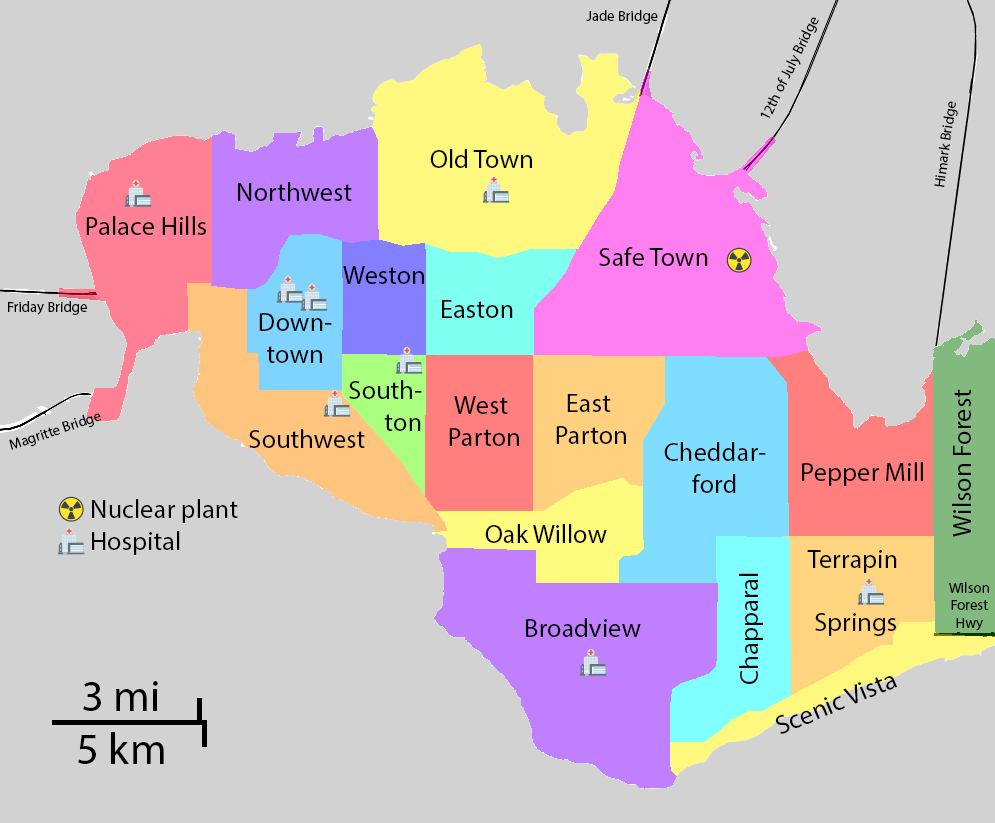
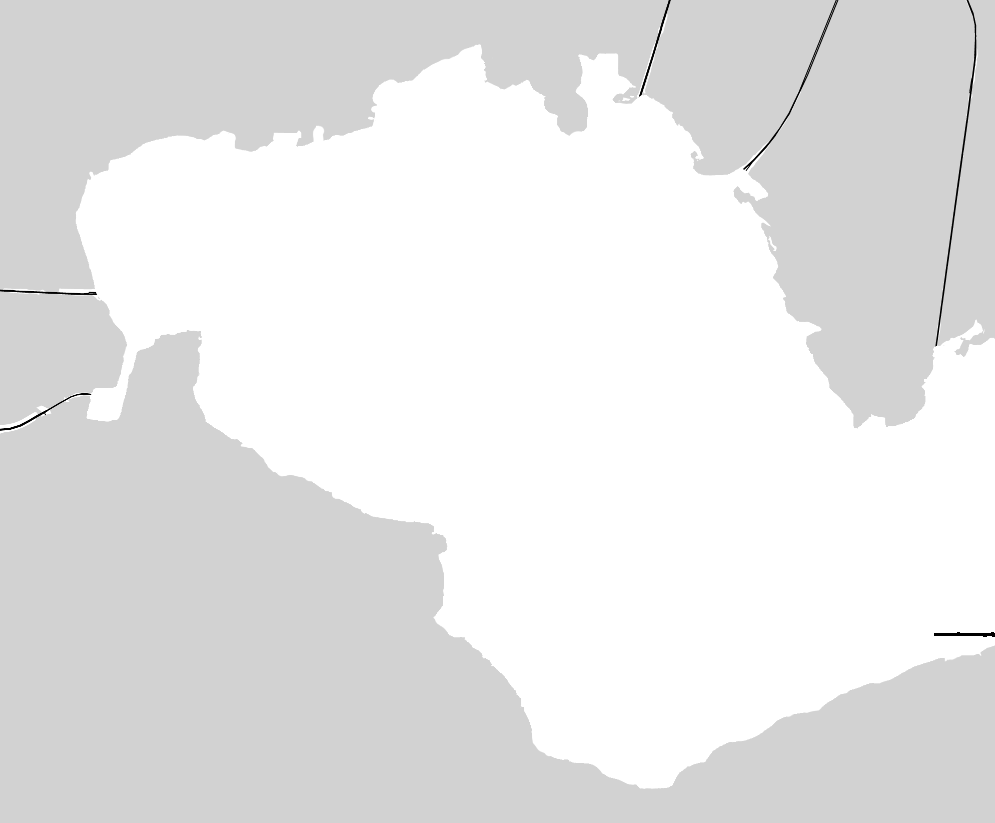

In [263]:

#Define the map with starting coordinates
fig=folium.Figure(width=840,height=650)
fol_map = folium.Map([0.1192925, -119.8558755],tiles=None,zoom_start=12,
                    min_zoom=11, max_zoom=14,
                    max_bounds=True,
                    min_lon=-120, max_lon=-119.711751, 
                    min_lat=0, max_lat=0.238585,
                    prefer_canvas=False
                    ).add_to(fig)

#Add shapefile
folium.GeoJson(data=shapefile["geometry"]).add_to(fol_map)

#Overlay png of the city on map
folium.raster_layers.ImageOverlay(
    image="/Users/alexanderlindell/Documents/Programmering /Python/TNM098/Project/VC files/data/StHimarkNeighborhoodMap.png",
    name="StHiMarkMap Details",
    bounds=[[0, -120],[0.238585, -119.711751]],
    opacity=1,
    interactive=False,
    cross_origin=False,
    zindex=1,
    
).add_to(fol_map)
folium.raster_layers.ImageOverlay(
    image="/Users/alexanderlindell/Documents/Programmering /Python/TNM098/Project/VC files/data/StHimarkMapBlank.png",
    name="StHiMarkMap Blank",
    bounds=[[0, -120],[0.238585, -119.711751]],
    opacity=1,
    interactive=False,
    cross_origin=False,
    zindex=1,
    
).add_to(fol_map)

#Powerplant marker as layer
powerplant = FeatureGroup(name='Always Safe Nuclear plant')
folium.Marker(
    radius=100,
    location=[0.162679,-119.784825],
    popup='Always Safe Nuclear plant',
    color="yellow",
    fill=True,
    alpha=0.5
).add_to(powerplant)
fol_map.add_child(powerplant)

#Heatmap of mobilesensors as layer
heatmobilesensors=mobilesensors.loc[(mobilesensors['Value']>60) & (mobilesensors['Value']<10000)].copy()
max=heatmobilesensors['Value'].max()
heatmobilesensors['Weight']=(heatmobilesensors['Value']/max)
heatmobilesensors.sort_values(by='Timestamp')
mobiledata=[]
for x,y,z in zip(heatmobilesensors['Lat'],heatmobilesensors['Long'],heatmobilesensors['Weight']):
    mobiledata.append([x,y,z])
mobileheatmap=FeatureGroup(name='Heatmap of Mobilesensors')
plugins.HeatMap(mobiledata,radius=8,blur=10).add_to(mobileheatmap)
fol_map.add_child(mobileheatmap)

#Heatmap of staticsensors as layer
heatstaticsensors=staticsensors.loc[staticsensors['Value']>60].copy()
heatstaticsensors['Weight']=(heatstaticsensors['Value']/max)
heatstaticsensors.sort_values(by='Timestamp')
staticdata=[]
for x,y,z in zip(heatstaticsensors['Lat'],heatstaticsensors['Long'],heatstaticsensors['Weight']):
    staticdata.append([x,y,z])
staticheatmap=FeatureGroup(name='Heatmap of Staticsensors')
plugins.HeatMap(staticdata,radius=10,blur=10).add_to(staticheatmap)
fol_map.add_child(staticheatmap)

#Heatmap of mobilesensors filtered as layer
heatmobilesensorsfilt=mobilesensorsfiltered.copy()
heatmobilesensorsfilt['Weight']=(heatmobilesensorsfilt['Value']/max)
heatmobilesensorsfilt.sort_values(by='Timestamp')
mobiledatafilt=[]
for x,y,z in zip(heatmobilesensorsfilt['Lat'],heatmobilesensorsfilt['Long'],heatmobilesensorsfilt['Weight']):
    mobiledatafilt.append([x,y,z])
mobileheatmapfilt=FeatureGroup(name='Heatmap of Mobilesensors filtered')
plugins.HeatMap(mobiledatafilt,radius=10,blur=10).add_to(mobileheatmapfilt)
fol_map.add_child(mobileheatmapfilt)

#Heatmap of staticsensors filtered as layer
heatstaticsensorsfilt=staticsensorsfiltered.copy()
heatstaticsensorsfilt['Weight']=(heatstaticsensorsfilt['Value']/heatmobilesensors['Value'].max())
heatstaticsensorsfilt.sort_values(by='Timestamp')
staticdatafilt=[]
for x,y,z in zip(heatstaticsensorsfilt['Lat'],heatstaticsensorsfilt['Long'],heatstaticsensorsfilt['Weight']):
    staticdatafilt.append([x,y,z])
staticheatmapfilt=FeatureGroup(name='Heatmap of Staticsensors filtered')
plugins.HeatMap(staticdatafilt,radius=10,blur=10).add_to(staticheatmapfilt)
fol_map.add_child(staticheatmapfilt)

#Animation of staticsensors
TimestampedGeoJson( staticfeatures,
                    add_last_point = False,
                    period='PT2H',
                    auto_play=False,
                    loop_button=True,
                    time_slider_drag_update=True,
                    transition_time = 200
                    #duration='PT1M'
                    ).add_to(fol_map)

#Animation of mobilesensors
TimestampedGeoJson( mobilefeatures,
                    add_last_point = False,
                    period='PT2H',
                    auto_play=False,
                    loop_button=True,
                    time_slider_drag_update=True,
                    transition_time = 200
                    #duration='PT1M'
                    ).add_to(fol_map)

folium.LayerControl(position='topleft').add_to(fol_map)
fol_map.add_child(colorbar)
fol_map

In [ ]:
#Save map to a html file
fol_map.save('RadiationReadings.html')

Trying classifiers to isolate groups of sensor readings 

In [ ]:
#DBSCAN classification
coords = mobileandstatic[['Lat','Long']].to_numpy()
kms_per_radian = 6371.0088
epsilon = 1.2 / kms_per_radian

db = DBSCAN(eps=epsilon, min_samples=50, algorithm='ball_tree', metric='haversine')

rad=np.radians(coords)


db.fit(rad)

cluster_labels = db.labels_
num_clusters = len(set(cluster_labels))
clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
print('Number of clusters: {}'.format(num_clusters))

#Kmeans classification 
coords = mobileandstatic[['Lat','Long']].to_numpy()
kmeans=KMeansConstrained(
        init='random',
        n_clusters=50,
        n_init=50,
        size_min=21,
        size_max=300,
        max_iter=500,
        random_state=42
)
kmeans.fit(coords)
labels = kmeans.labels_
mobileandstatic['cluster'] = labels
len(mobileandstatic['cluster'].unique())

#RadiusNeighborsClassifier
coords = mobileandstatic[['Lat','Long']].to_numpy()
neighbor=RadiusNeighborsClassifier(radius=1.0,weights='uniform',algorithm='ball_tree',metric='haversine')
rad=np.radians(coords)
neighbor.fit(rad)
cluster_labels = neighbor.labels_
num_clusters = len(set(cluster_labels))
clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
print('Number of clusters: {}'.format(num_clusters))